In [89]:
from DataSet import DataSet
import sklearn
import matplotlib.pyplot as plt 
import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import random
from os import listdir
from os.path import isfile, join
import re
import os
import numpy as np
device = torch.device("cpu")

manual_seed = 12
random.seed(manual_seed)
torch.manual_seed(manual_seed)

In [20]:
from models.vgg_32 import Encoder
from models.vgg_32 import Decoder

class Model:
    def __init__(self, path, batch=32):
        # load torch model from path
        # path is a directory containing encoder and decoder files with names starting with "encoder" and "decoder"
        Encoder()
        Decoder()
        self.batch = batch
        # get encoder path
        encoder_path = [f for f in listdir(path) if isfile(join(path, f)) and re.match(r"encoder*", f)]
        if len(encoder_path) != 1:
            raise Exception("Could not find encoder file")
        self.encoder_path = join(path, encoder_path[0])
        # get decoder path
        decoder_path = [f for f in listdir(path) if isfile(join(path, f)) and re.match(r"decoder*", f)]
        if len(decoder_path) != 1:
            raise Exception("Could not find decoder file")
        self.decoder_path = join(path, decoder_path[0])
        # load encoder and decoder
        self.encoder = torch.load(self.encoder_path, map_location=device)
        self.decoder = torch.load(self.decoder_path, map_location=device)
    
    def get_embeddings(self, images):
        # split imagdes to batches
        batches = [images[i:i+self.batch] for i in range(0, len(images), self.batch)]
        def wrapper():
            for b in batches:
                # get embeddings for batch with no gradient
                with torch.no_grad():
                    yield self.encoder(torch.tensor(b)).detach().numpy()
        return np.concatenate(list(wrapper()))
    
    def get_reconstructions(self, images):
        # split imagdes to batches
        batches = [images[i:i+self.batch] for i in range(0, len(images), self.batch)]
        def wrapper():
            for b in batches:
                # get reconstructions for batch with no gradient
                with torch.no_grad():
                    yield self.decoder(self.encoder(torch.tensor(b))).detach().numpy()
        return np.concatenate(list(wrapper()))


In [56]:
def ishows(*lsts, frac=0):
    columns = len(lsts)
    rows = len(lsts[0])
    fig, axs = plt.subplots(rows, columns, figsize=(4*columns, 4*rows))
    for i in range(rows):
        for j in range(columns):
            axs[i][j].imshow(lsts[j][i, frac], aspect='auto')


def call_function_for_all_data(function, path_to_dataset):
    # get all files in path_to_dataset
    files = [join(path_to_dataset, f) for f in listdir(path_to_dataset) if isfile(join(path_to_dataset, f))]
    # numpy arrays for all data
    total_data = None
    total_head = None
    total_input = None

    for file in files:
        print('processing file: ' + file)
        data = np.load(file)
        img = data['data']
        head = data['head']
        # concat function results using np.concatenate
        if total_data is None:
            total_data = function(img)
        else:
            total_data = np.concatenate((total_data, function(img)))
        # concat head using np.concatenate
        if total_head is None:
            total_head = head
        else:
            total_head = np.concatenate((total_head, head))
        # concat input using np.concatenate
        if total_input is None:
            total_input = img
        else:
            total_input = np.concatenate((total_input, img))
    return total_data, total_head, total_input


def create_model(*args, **kwargs):
    # we will attach the call_function_for_all_data method to each model for convenience
    m = Model(*args, **kwargs)
    m.call_get_embeddings_for_all = lambda dataset: call_function_for_all_data(m.get_embeddings, dataset)
    m.call_get_reconstructions_for_all = lambda dataset: call_function_for_all_data(m.get_reconstructions, dataset)
    return m


# Test

In [57]:
m = create_model("data/pretrained_models/vgg19N3_dim=128", batch=4)
tmp = m.call_get_reconstructions_for_all("data/test_data/")

processing file: data/test_data/xy_0.npz
processing file: data/test_data/xy_16.npz
processing file: data/test_data/xy_24.npz
processing file: data/test_data/xy_32.npz
processing file: data/test_data/xy_40.npz
processing file: data/test_data/xy_8.npz


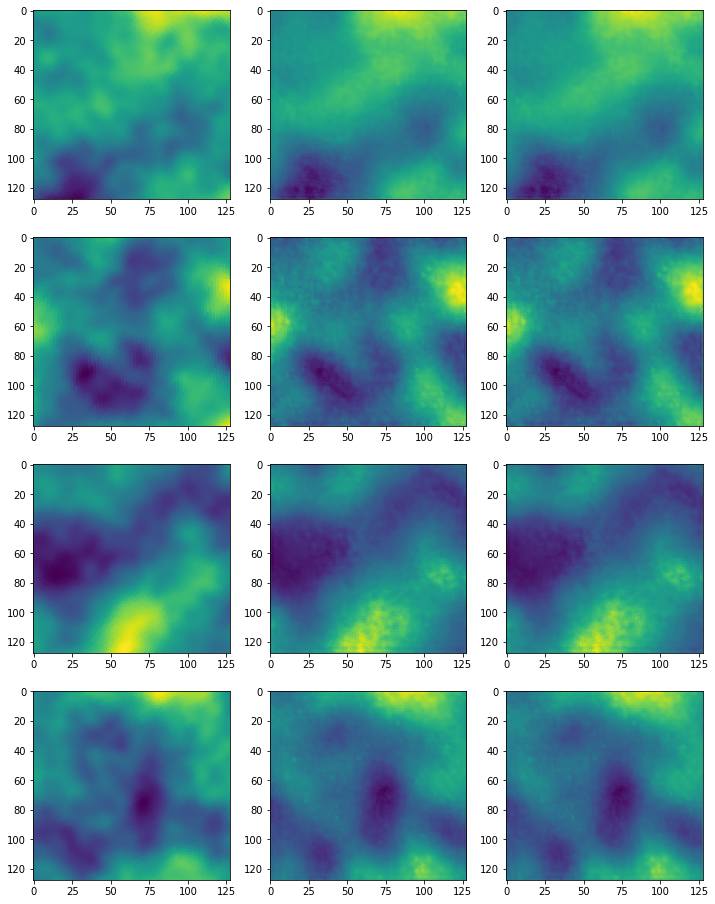

In [51]:
model_input = tmp[2][0:4]
model_output = tmp[0][0:4]
model_output_transformed = np.copy(model_output)
model_output_transformed[model_output_transformed < model_input.min()] = model_input.min()
model_output_transformed[model_output_transformed > model_input.max()] = model_input.max()
ishows(model_input, model_output, model_output_transformed)

# Found best model


In [59]:
import time

models = [
    'data/pretrained_models/vgg1',
    'data/pretrained_models/vgg3',
    'data/pretrained_models/vgg19N3_dim=128',
    'data/pretrained_models/vgg19N3_dim=1000',
]

for model in models:
    print("model: " + model)
    m = create_model(model, batch=8)

    t = time.time()
    output, heads, input = m.call_get_reconstructions_for_all("data/test_data/")
    print()
    print("time: " + str(time.time() - t))
    print()

    mse = np.sum((output - input) ** 2, axis=(1,2,3)) / (7*128*128)
    # print model statistics
    print("mse mean: " + str(mse.mean()))
    print("mse std: " + str(mse.std()))
    print("mse min: " + str(mse.min()))
    print("mse max: " + str(mse.max()))
    print("mse median: " + str(np.median(mse)))
    print("\n\n====================\n\n")

model: data/pretrained_models/vgg1
processing file: data/test_data/xy_0.npz
processing file: data/test_data/xy_16.npz
processing file: data/test_data/xy_24.npz
processing file: data/test_data/xy_32.npz
processing file: data/test_data/xy_40.npz
processing file: data/test_data/xy_8.npz

time: 41.8213574886322

mse mean: 10.149542578274295
mse std: 21.169711843105375
mse min: 0.0647057294845581
mse max: 72.26028006417411
mse median: 1.487595558166504




model: data/pretrained_models/vgg3
processing file: data/test_data/xy_0.npz
processing file: data/test_data/xy_16.npz
processing file: data/test_data/xy_24.npz
processing file: data/test_data/xy_32.npz
processing file: data/test_data/xy_40.npz
processing file: data/test_data/xy_8.npz

time: 162.50294089317322

mse mean: 20.35999139336248
mse std: 49.29497236032912
mse min: 0.039026030472346714
mse max: 164.03355189732142
mse median: 0.8582150254930768




model: data/pretrained_models/vgg19N3_dim=128
processing file: data/test_data/xy_0.n

# Found anomalies for MSE between input and reconstruction images

In [60]:
m = create_model("data/pretrained_models/vgg19N3_dim=128", batch=4)

output, heads, input = m.call_get_reconstructions_for_all("data/test_data/")
mse = np.sum((output - input) ** 2, axis=(1,2,3)) / (7*128*128)
greatest = np.argsort(mse)[::-1]

processing file: data/test_data/xy_0.npz
processing file: data/test_data/xy_16.npz
processing file: data/test_data/xy_24.npz
processing file: data/test_data/xy_32.npz
processing file: data/test_data/xy_40.npz
processing file: data/test_data/xy_8.npz


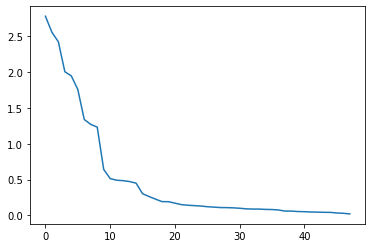

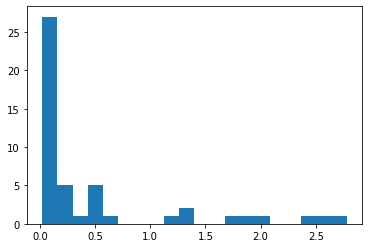

In [80]:
plt.figure()
plt.plot(mse[greatest])
plt.figure()
x=plt.hist(mse, bins=20)

[2.77899933 2.55587905 2.42217527 2.00444944 1.94603879 1.75728907
 1.33742782 1.26988861 1.23142747 0.64159278 0.51305073 0.49015117
 0.48400535 0.47146801 0.44939354 0.30220883 0.26244152 0.22652168
 0.19145475 0.19059166 0.1700362  0.14967302 0.14094568 0.13554405
 0.12971668 0.12057628 0.11509246 0.10849795 0.10784382 0.10456514]
[[ 1.00000000e+00 -3.35869158e+01  5.40560907e+01]
 [ 1.00000000e+00 -1.03984881e+02 -2.45333986e+01]
 [ 1.00000000e+00  7.60181788e+01 -1.43184683e+01]
 [ 1.00000000e+00  4.25748079e+01  1.64727113e+01]
 [ 1.00000000e+00  3.53995122e+01  2.67266079e+01]
 [ 1.00000000e+00 -1.49324455e+02 -2.27024211e+01]
 [ 1.00000000e+00  8.78047969e+01  1.62288280e+01]
 [ 1.00000000e+00  7.57100653e+01 -5.52809729e+01]
 [ 1.00000000e+00 -1.77973080e+02  2.87102967e+01]
 [ 1.00000000e+00 -1.75284510e+02  6.89632390e+01]
 [ 1.00000000e+00  7.16424501e+01  1.48004553e+01]
 [ 1.00000000e+00  9.03402524e+01 -5.36246361e+01]
 [ 1.00000000e+00 -2.99269457e+01  2.22098847e+01]
 

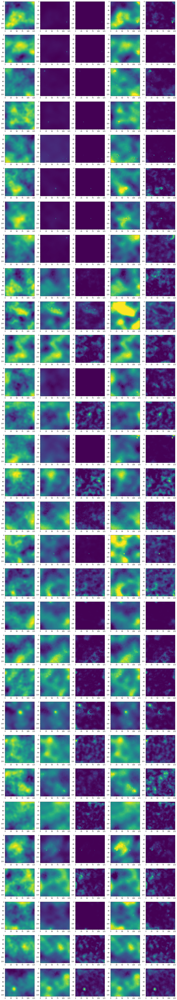

In [81]:
output_transformed = np.copy(output)
for i in range(len(output)):
    # replace values in output_transformed that are out of range input.min() and input.max()
    output_transformed[i][output_transformed[i] < input[i].min()] = input[i].min()
    output_transformed[i][output_transformed[i] > input[i].max()] = input[i].max()
greatest_n = greatest[:30]
error = (input[greatest_n] - output[greatest_n]) ** 2
error_transformed = (input[greatest_n] - output_transformed[greatest_n]) ** 2
ishows(input[greatest_n], output[greatest_n], error, output_transformed[greatest_n], error_transformed)
print(mse[greatest_n])
print(heads[greatest_n])

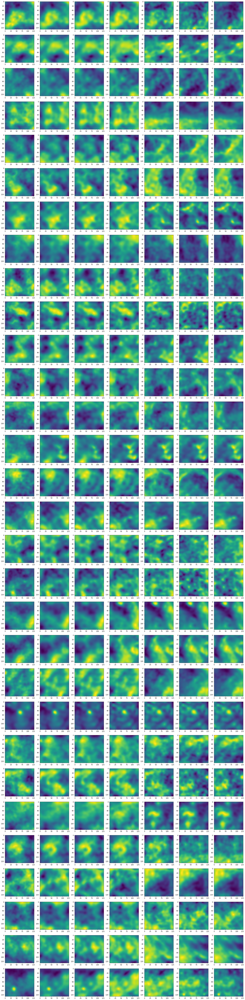

In [83]:
imgs = input[greatest_n]
ishows(imgs[:, 0:1], imgs[:, 1:2], imgs[:, 2:3], imgs[:, 3:4], imgs[:, 4:5], imgs[:, 5:6], imgs[:, 6:7])

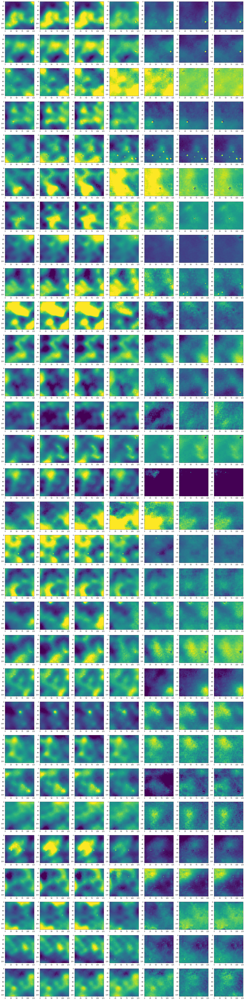

In [86]:
imgs = output_transformed[greatest_n]
ishows(imgs[:, 0:1], imgs[:, 1:2], imgs[:, 2:3], imgs[:, 3:4], imgs[:, 4:5], imgs[:, 5:6], imgs[:, 6:7])

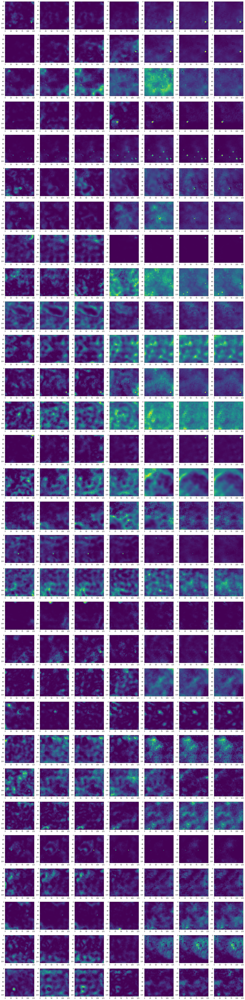

In [87]:
imgs = (input[greatest_n] - output_transformed[greatest_n]) ** 2
ishows(imgs[:, 0:1], imgs[:, 1:2], imgs[:, 2:3], imgs[:, 3:4], imgs[:, 4:5], imgs[:, 5:6], imgs[:, 6:7])

# Found anomalies by clustering embeddings

In [88]:
m = create_model("data/pretrained_models/vgg19N3_dim=128", batch=4)

output, heads, input = m.call_get_embeddings_for_all("data/test_data/")

processing file: data/test_data/xy_0.npz
processing file: data/test_data/xy_16.npz
processing file: data/test_data/xy_24.npz
processing file: data/test_data/xy_32.npz
processing file: data/test_data/xy_40.npz
processing file: data/test_data/xy_8.npz


In [102]:
from sklearn import cluster
clusters = cluster.DBSCAN(eps=1.5, min_samples=3).fit_predict(output)
clusters

array([ 0,  0, -1,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0, -1,
        0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1,
        0,  0,  0, -1,  0,  0,  0,  0, -1,  0,  0,  0,  0, -1])

In [106]:
# get indices of -1 clusters
outliers = np.where(clusters == -1)[0]
outliers

array([ 2,  8, 16, 20, 33, 37, 42, 47])

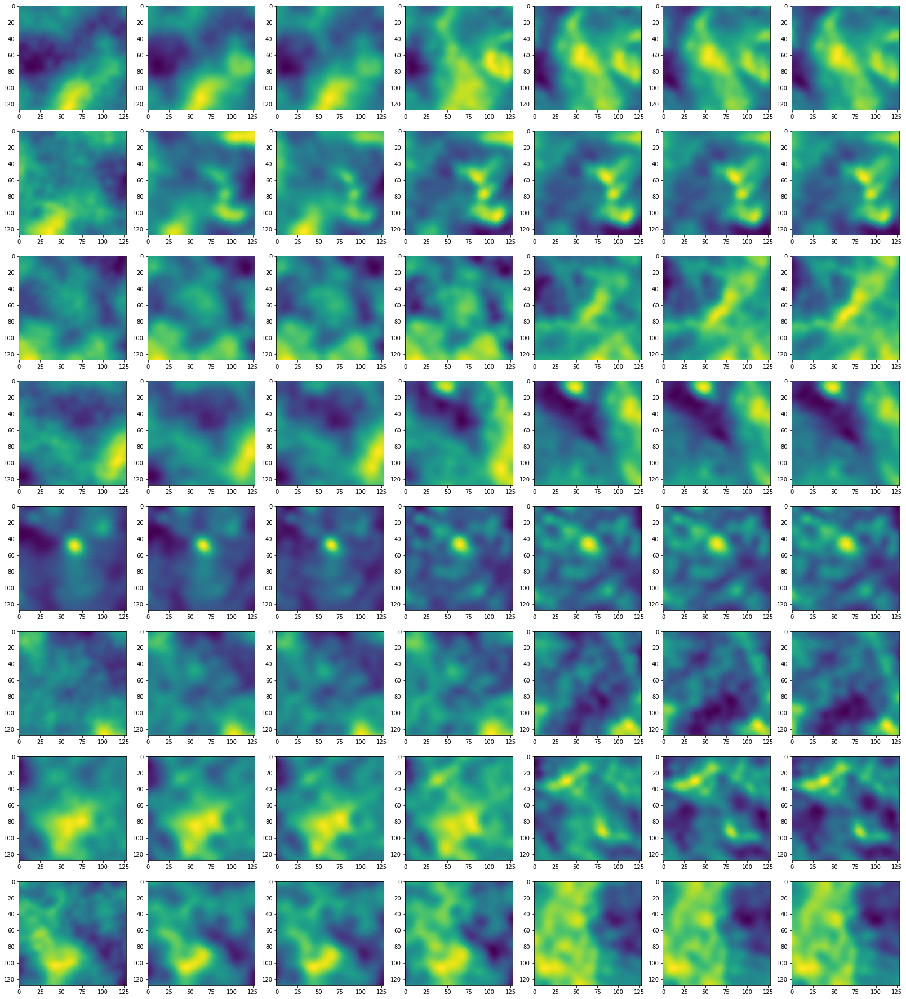

In [107]:
imgs = input[outliers]
ishows(imgs[:, 0:1], imgs[:, 1:2], imgs[:, 2:3], imgs[:, 3:4], imgs[:, 4:5], imgs[:, 5:6], imgs[:, 6:7])

# PCA with histogram outliers

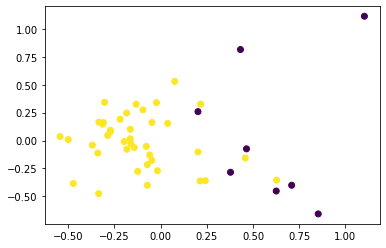

In [149]:
from sklearn.decomposition import PCA

pca_embeddings = PCA(n_components=2).fit_transform(output)
plt.scatter(pca_embeddings[:, 0], pca_embeddings[:, 1], c=clusters)

In [150]:
pca = PCA(n_components=25)
pca_embeddings = pca.fit_transform(output)
print('compresed data:', pca_embeddings.shape)
print('variance ratio:', pca.explained_variance_ratio_)
print('total variance:', sum(pca.explained_variance_ratio_))
print('singular values:', pca.singular_values_)

compresed data: (48, 25)
variance ratio: [0.10062598 0.08192371 0.07947002 0.06941988 0.06265841 0.05471954
 0.04872501 0.04688371 0.04516441 0.0394056  0.03373383 0.02881134
 0.02705471 0.0248151  0.02357224 0.02118367 0.01706999 0.01623596
 0.01597378 0.01519329 0.01382467 0.01353847 0.01293251 0.01159146
 0.01092305]
total variance: 0.9154503438621759
singular values: [2.5132778  2.267724   2.2335057  2.0875041  1.9832392  1.8533466
 1.7488855  1.7155225  1.6837732  1.572767   1.455185   1.3448292
 1.3031874  1.2480828  1.2164265  1.1531506  1.035147   1.0095419
 1.0013577  0.9765879  0.9315642  0.92187124 0.9010043  0.8530108
 0.8280514 ]


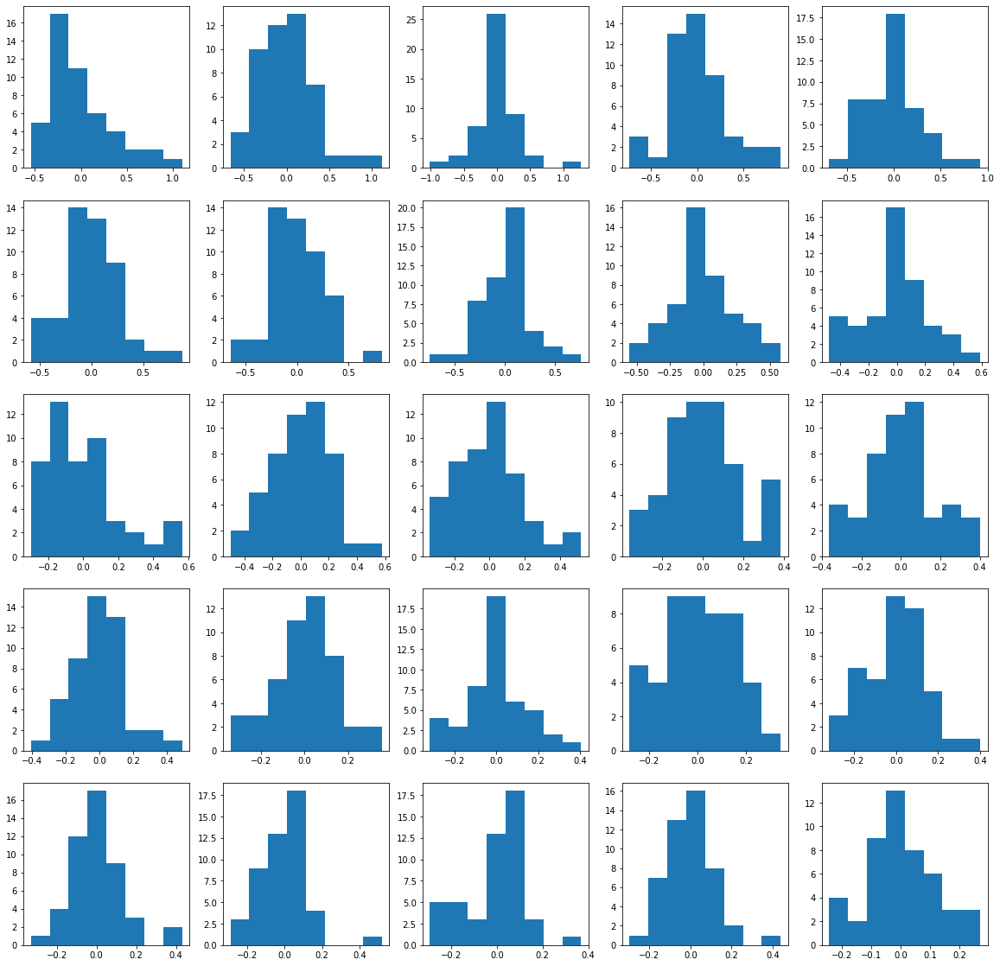

In [196]:
outliers = {i: 0 for i in range(pca_embeddings.shape[0])}

columns = 5
rows = 5
fig, axs = plt.subplots(rows, columns, figsize=(4*columns, 4*rows))
for i in range(rows):
    for j in range(columns):
        if i*columns + j >= pca_embeddings.shape[1]:
            break
        axs[i][j].hist(pca_embeddings[:, i*columns + j], bins=8)
        # substraction from outliers quantile from interval
        quantile_low = np.quantile(pca_embeddings[:, i*columns + j], 0.1)
        quantile_high = np.quantile(pca_embeddings[:, i*columns + j], 0.9)
        normal_data = np.where((pca_embeddings[:, i*columns + j] > quantile_low) & (pca_embeddings[:, i*columns + j] < quantile_high))[0]
        for n in normal_data:
            outliers[n] += 1

In [197]:
# sort outliers by values
# loweres values may be outliers
outliers = {k: v for k, v in sorted(outliers.items(), key=lambda item: item[1])}
outliers

{2: 14,
 24: 14,
 6: 15,
 42: 15,
 25: 16,
 28: 16,
 13: 17,
 26: 17,
 30: 17,
 36: 17,
 8: 18,
 14: 18,
 16: 18,
 17: 18,
 20: 18,
 27: 18,
 31: 18,
 44: 18,
 4: 19,
 7: 19,
 15: 19,
 19: 19,
 37: 19,
 38: 20,
 40: 20,
 46: 20,
 47: 20,
 0: 21,
 12: 21,
 18: 21,
 29: 21,
 33: 21,
 41: 21,
 43: 21,
 5: 22,
 10: 22,
 34: 22,
 45: 22,
 11: 23,
 21: 23,
 23: 23,
 35: 23,
 1: 24,
 9: 24,
 32: 24,
 39: 24,
 3: 25,
 22: 25}

In [198]:
# get first 5 outliers
greatest = [k for k, v in sorted(outliers.items(), key=lambda item: item[1])]
greatest_n = greatest[:5]
greatest_n

[2, 24, 6, 42, 25]

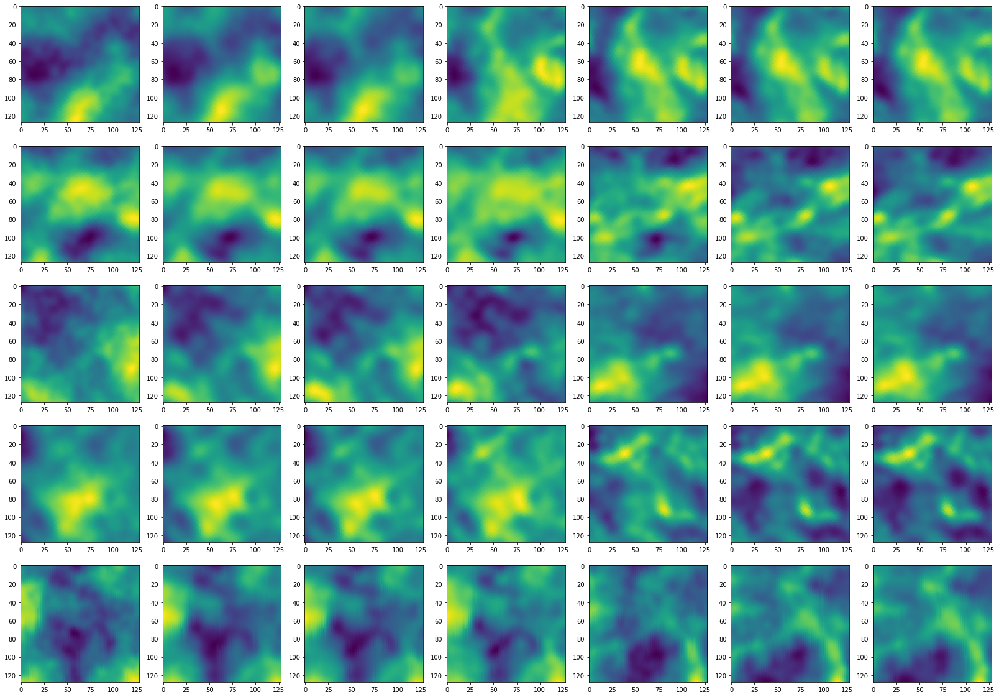

In [199]:
imgs = input[greatest_n]
ishows(imgs[:, 0:1], imgs[:, 1:2], imgs[:, 2:3], imgs[:, 3:4], imgs[:, 4:5], imgs[:, 5:6], imgs[:, 6:7])